<a href="https://colab.research.google.com/github/Andreea-Savu7/SpeechRecognition/blob/main/SpeechRecognitionUdemy.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [30]:
import numpy as np
import matplotlib.pyplot as plt


In [31]:
!pip install SpeechRecognition librosa soundfile jiwer wisper
import librosa
import librosa.display
import soundfile as sf
import speech_recognition as sr
from jiwer import wer, cer
from IPython.display import Audio
import wisper

In [32]:
!pip install gTTS
import csv
import os
import tempfile
import wave
from gtts import gTTS

In [33]:
from google.colab import files
uploaded = files.upload()

Saving speech_01.wav to speech_01 (1).wav


In [34]:
audio_signal, sample_rate = librosa.load('speech_01.wav', sr=None)

In [35]:
sample_rate

44100

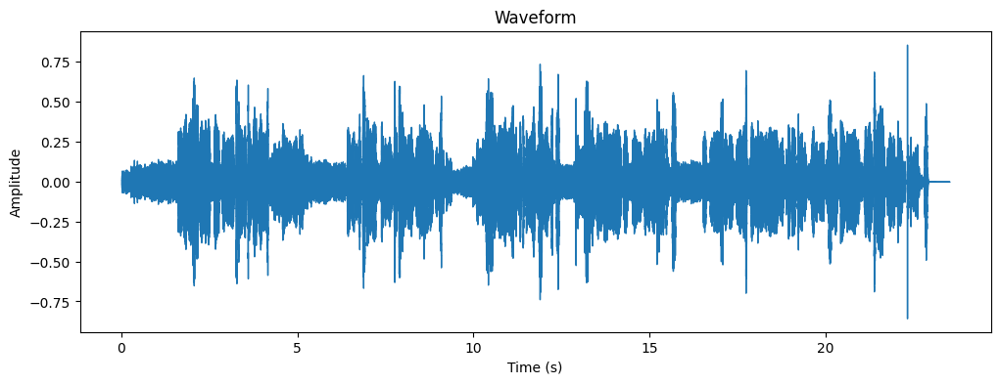

In [36]:
plt.figure(figsize=(12, 4))
librosa.display.waveshow(audio_signal, sr=sample_rate)
plt.title('Waveform')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude')
plt.show()

Audio('speech_01.wav')

In [37]:
recognizer = sr.Recognizer()

In [38]:
file_path = 'speech_01.wav'

In [39]:
def transcribe_audio(file_path):
  with sr.AudioFile(file_path) as source:
    audio_data = recognizer.record(source)
    text = recognizer.recognize_google(audio_data)
    print(text)
    return text

transcribed_text = transcribe_audio(file_path)

my name is Yvonne and I am excited to have you as part of our Learning Community before we get started I'd like to tell you a little bit about myself I'm a sound engineer term data scientist curious about machine learning and artificial intelligence my professional background is primarily in media production with a focus on audio it and Communications


In [41]:
ground_truth ="""My name is Ivan and I am excited to have you as part of our learning community!
Before we get started, I’d like to tell you a little bit about myself. I’m a sound engineer turned data scientist,
curious about machine learning and Artificial Intelligence. My professional background is primarily in media production,
with a focus on audio, IT, and communications"""

In [42]:
!pip install jiwer
from jiwer import wer, cer

In [43]:
calculated_wer = wer(ground_truth, transcribed_text)
calculated_cer = cer(ground_truth, transcribed_text)
print(f"Word Error Rate (WER): {calculated_wer:.4f}")
print(f"Character Error Rate (CER): {calculated_cer:.4f}")

Word Error Rate (WER): 0.3448
Character Error Rate (CER): 0.0859


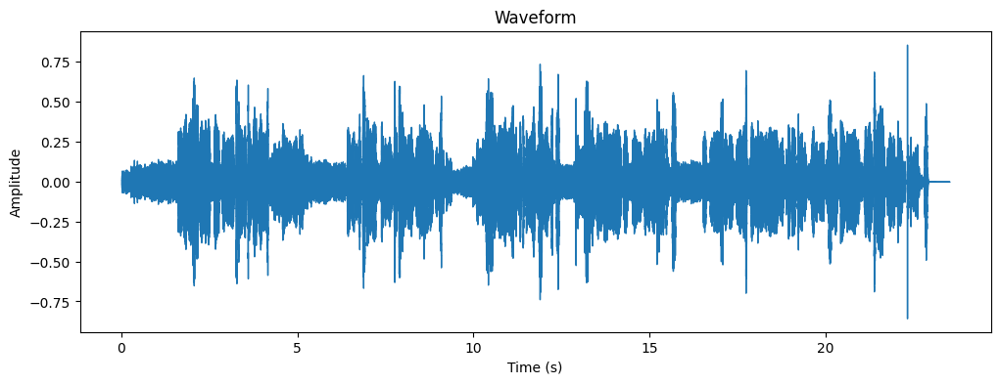

In [45]:
plt.figure(figsize=(12, 4))
librosa.display.waveshow(audio_signal, sr=sample_rate)
plt.title('Waveform')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude')
plt.show()

Audio('speech_01.wav')

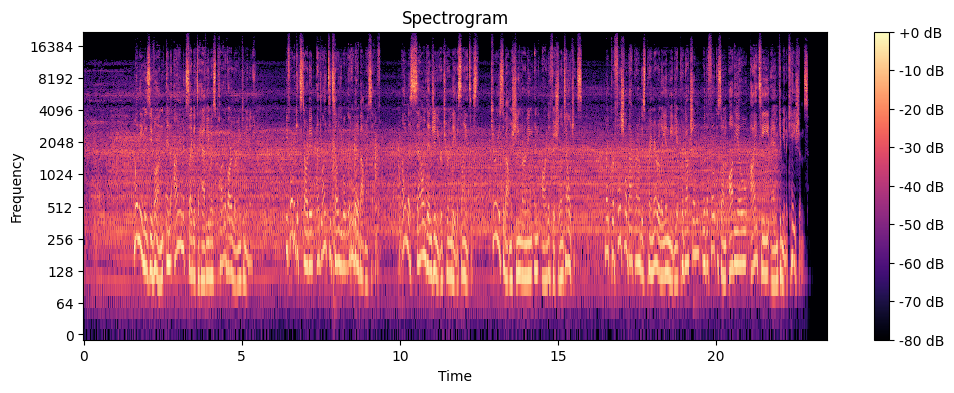

In [47]:
S = librosa.stft(audio_signal)
S_db = librosa.amplitude_to_db(abs(S), ref=np.max)
plt.figure(figsize=(12, 4))
librosa.display.specshow(data = S_db, sr=sample_rate, x_axis='time', y_axis='log')
plt.colorbar(format='%+2.0f dB')
plt.title('Spectrogram')
plt.xlabel('Time')
plt.ylabel('Frequency')
plt.show()

In [48]:
signal_filtered = librosa.effects.preemphasis(audio_signal, coef=0.97)
sf.write('filtered_speech_01.wav', signal_filtered, sample_rate)
output_file ='filtered_speech_01.wav'


In [49]:
Audio(output_file)

In [50]:
Sb = librosa.stft(signal_filtered)
S_dBb = librosa.amplitude_to_db(abs(Sb), ref=np.max)

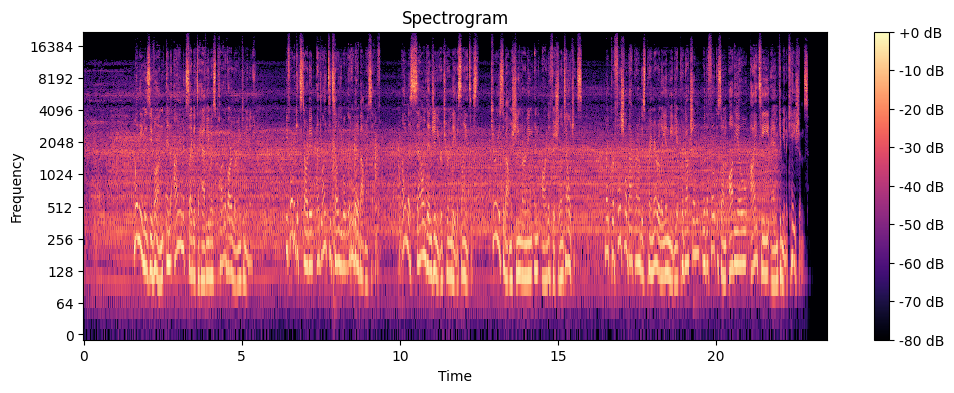

In [51]:
plt.figure(figsize=(12, 4))
librosa.display.specshow(data = S_db, sr=sample_rate, x_axis='time', y_axis='log')
plt.colorbar(format='%+2.0f dB')
plt.title('Spectrogram')
plt.xlabel('Time')
plt.ylabel('Frequency')
plt.show()

In [52]:
transcribed_text_preemphasis = transcribe_audio('filtered_speech_01.wav')

my name is Yvonne and I am excited to have you as part of our Learning Community before we get started I'd like to tell you a little bit about myself I'm a sound engineer turn data scientist curious about machine learning and artificial intelligence my professional background is primarily in media production with a focus on audio it and Communications


In [53]:
calculated_wer = wer(ground_truth, transcribed_text_preemphasis)
calculated_cer = cer(ground_truth, transcribed_text_preemphasis)
print(f"Word Error Rate (WER): {calculated_wer:.4f}")
print(f"Character Error Rate (CER): {calculated_cer:.4f}")

Word Error Rate (WER): 0.3448
Character Error Rate (CER): 0.0803


In [54]:
!pip install git+https://github.com/openai/whisper.git
import whisper
model = whisper.load_model("base")

  Cloning https://github.com/openai/whisper.git to /tmp/pip-req-build-zktr5uru
  Running command git clone --filter=blob:none --quiet https://github.com/openai/whisper.git /tmp/pip-req-build-zktr5uru
  Resolved https://github.com/openai/whisper.git to commit 517a43ecd132a2089d85f4ebc044728a71d49f6e
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done


/usr/local/lib/python3.11/dist-packages/whisper/__init__.py:150: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  checkpoint = torch.load(fp, map_location=device)


In [55]:
result = model.transcribe(file_path)

/usr/local/lib/python3.11/dist-packages/whisper/transcribe.py:132: UserWarning: FP16 is not supported on CPU; using FP32 instead
  warnings.warn("FP16 is not supported on CPU; using FP32 instead")


In [56]:
transcribed_text_whisper = result["text"]
print(transcribed_text_whisper)

 My name is Yvonne and I am excited to have you as part of our learning community. Before we get started, I'd like to tell you a little bit about myself. I'm a sound engineer turned a scientist, curious about machine learning and artificial intelligence. My professional background is primarily in media production, with a focus on audio, IT and communications.


In [57]:
result["language"]

'en'

In [58]:
calculated_wer = wer(ground_truth, transcribed_text_whisper)
calculated_cer = cer(ground_truth, transcribed_text_whisper)
print(f"Word Error Rate (WER): {calculated_wer:.4f}")
print(f"Character Error Rate (CER): {calculated_cer:.4f}")

Word Error Rate (WER): 0.2414
Character Error Rate (CER): 0.0471


In [85]:
import os
print(os.listdir('/content'))
from google.colab import files
uploaded = files.upload()  # Încarcă fișiere
print(uploaded)  # Vezi ce fișiere au fost încărcate
def transcribe_directory_whisper():
    transcription = []  # Listează transcrierea fiecărui fișier
    for file_name in uploaded.keys():  # Iterează prin fișierele încărcate
        if file_name.endswith(".wav"):  # Verifică fișierele .wav
            file_path = f"/content/{file_name}"  # Folosește calea corectă în Colab
            print(f"Processing file: {file_path}")  # Afișează fișierul care este procesat
            result = model.transcribe(file_path)  # Transcriere cu Whisper
            transcription.append(result["text"])  # Adaugă textul transcris în listă
    return transcription

['.config', 'speech_01 (1).wav', 'speech_01.wav', 'filtered_speech_01.wav', 'sample_data']


Saving speech_01.wav to speech_01 (2).wav
{'speech_01 (2).wav': b'RIFF\xaey/\x00WAVEfmt \x10\x00\x00\x00\x01\x00\x01\x00D\xac\x00\x00\xcc\x04\x02\x00\x03\x00\x18\x00bextZ\x02\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x

In [87]:
os.path.exists("/content/speech_01.wav")

True

In [89]:
transcriptions = transcribe_directory_whisper()

Processing file: /content/speech_01 (2).wav


/usr/local/lib/python3.11/dist-packages/whisper/transcribe.py:132: UserWarning: FP16 is not supported on CPU; using FP32 instead
  warnings.warn("FP16 is not supported on CPU; using FP32 instead")


In [90]:
transcriptions

[" My name is Yvonne and I am excited to have you as part of our learning community. Before we get started, I'd like to tell you a little bit about myself. I'm a sound engineer turned a scientist, curious about machine learning and artificial intelligence. My professional background is primarily in media production, with a focus on audio, IT and communications."]

In [92]:
def transcribe_directory_whisper():
    transcription = []  # Listează transcrierea fiecărui fișier
    for number, file_name in enumerate(uploaded.keys(), start=1):  # Iterează prin fișierele încărcate
        if file_name.endswith(".wav"):  # Verifică fișierele .wav
            file_path = f"/content/{file_name}"  # Folosește calea corectă în Colab
            print(f"Processing file: {file_path}")  # Afișează fișierul care este procesat
            result = model.transcribe(file_path)  # Transcriere cu Whisper
            # Salvează informațiile într-un dicționar
            transcription.append({
                'track_number': number,
                'file_name': file_name,
                'transcription': result["text"]
            })
    return transcription

In [94]:
from gtts import gTTS
from IPython.display import Audio

# Textul pentru conversia în vorbire
text = """Thank you for taking the time to watch our course on speech recognition! See you soon!"""

# Conversia textului în vorbire
tts = gTTS(text=text, lang='en')

# Salvarea fișierului audio
tts.save("speech.mp3")

# Redarea fișierului audio în Colab
Audio("speech.mp3")
